# Analysis of Steinmetz Neuropixels recordings of spontaneous activity (Week 3-4)

In [1]:
using Plots; gr()
using MAT, Printf, FileIO
using Images, ImageMagick
using LinearAlgebra, Statistics, Random
using Clustering, Distances
using BenchmarkTools

### Load Data

In [2]:
# Load all data in a three-element array of dictionaries
# Each element corresponding to each mouse maps variable names to their values  
mice_names = ["Krebs", "Waksman", "Robbins"]
data = [MAT.matread("./Data/$(mice_names[i])withFaces_KS2.mat") for i in 1:3];

### Visualize Spike Train

In [14]:
function dispSpikeTrain(data, id)
    max = maximum(data[id]["stall"])
    img = @. Gray(data[id]["stall"][:, 1:2500]/max)
    FileIO.save("./plots/spike_train_m$(id).png", img)
    
end

dispSpikeTrain (generic function with 2 methods)

### Spike Correlation

In [78]:
function spikeCorrel(data, names, id, disp::String)
    if disp == "unclustered" || disp == "clustered"
        cormat = cor(data[id]["stall"], dims=2)
        result = Clustering.hclust(ones(size(cormat)) - cormat, linkage=:ward)

        pos = (data[id]["iprobe"] * 5000) + data[id]["Wh"]
        temp_mat = repeat(pos, 1, length(pos))
        dist_mat = abs.(temp_mat - transpose(temp_mat))
        close_mat = ones(size(dist_mat)) - (dist_mat/maximum(dist_mat)) 
        #result = Clustering.hclust(dist_mat, linkage=:ward)

        if disp == "unclustered"
            p1 = heatmap(close_mat, title="Proximity")
            p2 = heatmap(cormat, clim=(-0.3, 1), title="Correlation")
        elseif disp == "clustered"
            p1 = heatmap(close_mat[result.order, result.order], title="Proximity")
            p2 = heatmap(cormat[result.order, result.order], clim=(-0.3, 1), title="Correlation")
        end
        plot(p1, p2, guide_position=:right, yflip=true, layout=(1, 2), size=(1200, 400))
        #savefig("./plots/$(names[id])_SpikeCorr.png")
    else
        println("Final input is wrong!")
    end
end

spikeCorrel (generic function with 1 method)

In [79]:
spikeCorrel(data, mice_names, 1, "unclustered")

In [7]:
spikeCorrel(data, mice_names, 2, "unclustered")

In [6]:
spikeCorrel(data, mice_names, 3, "unclustered")

In [121]:
spikeCorrel(data, mice_names, 2, "clustered")

In [122]:
spikeCorrel(data, mice_names, 3, "clustered")

## Testing clustering algorithms

In [3]:
# Generate points
x1 = rand(1:6, 10); y1 = rand(1:6, 10);
x2 = rand(4:10, 10); y2 = rand(4:10, 10);
shfl_idx = shuffle(1:20) 
x = vcat(x1, x2)[shfl_idx]; y = vcat(y1, y2)[shfl_idx];
scatter(x1, y1, markercolor=:red)
p1 = scatter!(x2, y2, markercolor=:blue, xlim=(0, 11), ylim=(0, 11), title="Generated")

# Construct distance matrix
x_temp = repeat(x, 1, length(x))
x_dif_sq = (x_temp - transpose(x_temp)) .^ 2
y_temp = repeat(y, 1, length(y))
y_dif_sq = (y_temp - transpose(y_temp)) .^ 2
dist_mat = sqrt.(x_dif_sq + y_dif_sq);

### Hierarchical Clustering

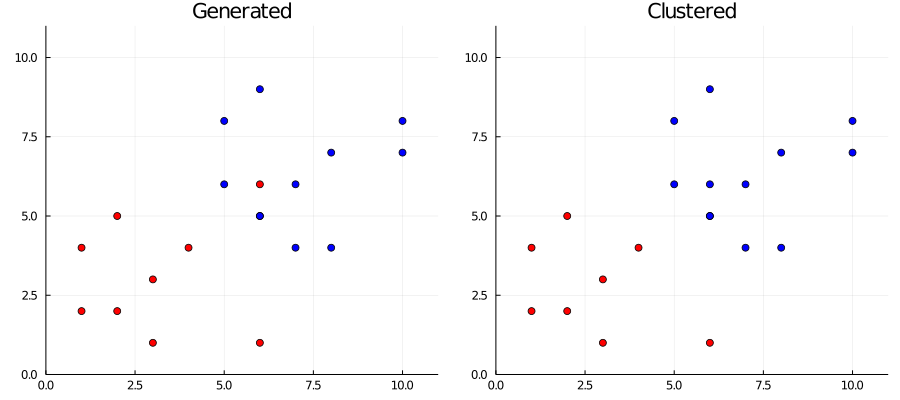

In [6]:
res = Clustering.hclust(dist_mat, linkage=:ward);
h = res.heights

asm = Clustering.cutree(res, k=2)
idx1 = asm .== 1
idx2 = asm .== 2
scatter(x[idx1], y[idx1], markercolor=:red)
p2 = scatter!(x[idx2], y[idx2], markercolor=:blue, ylim=(0, 11), xlim=(0, 11), title="Clustered")
plot(p1, p2, layout=(1, 2), legend=false, size=(900, 400))

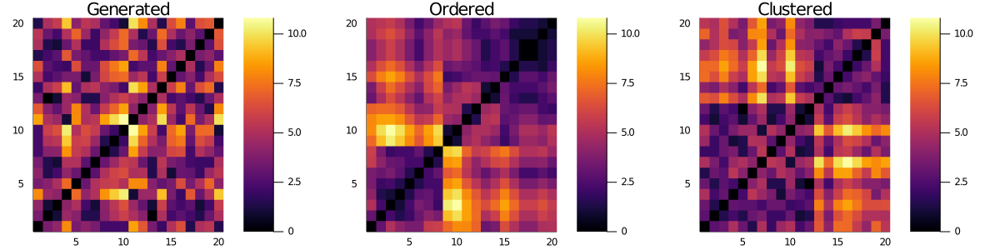

In [7]:
clust_idx = sortperm(asm)[end:-1:1]
p3 = heatmap(dist_mat, title="Generated")
p4 = heatmap(dist_mat[res.order, res.order], title="Ordered")
p5 = heatmap(dist_mat[clust_idx, clust_idx], title="Clustered")
plot(p3, p4, p5, layout=(1, 3), size=(1200, 300))

### K-medoids

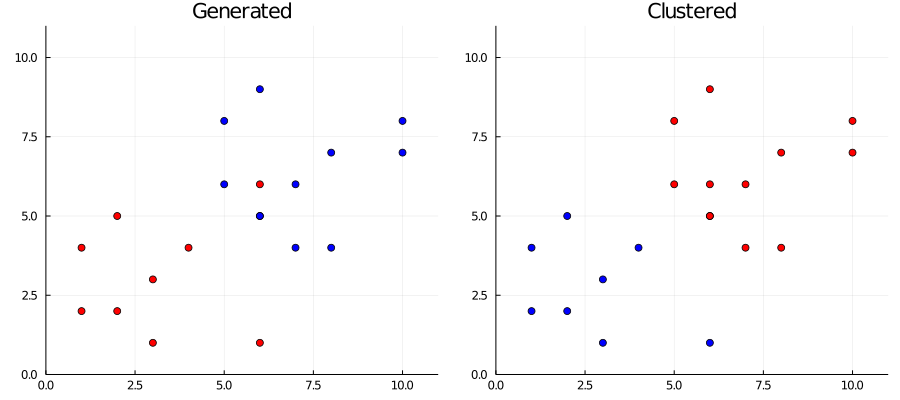

In [8]:
res = Clustering.kmedoids(dist_mat, 2)
asm = res.assignments
idx1 = asm .== 1
idx2 = asm .== 2
scatter(x[idx1], y[idx1], markercolor=:red)
p2 = scatter!(x[idx2], y[idx2], markercolor=:blue, ylim=(0, 11), xlim=(0, 11), title="Clustered")
plot(p1, p2, layout=(1, 2), legend=false, size=(900, 400))